<a href="https://colab.research.google.com/github/AdriVilla/Model-Tuning/blob/main/MT_Project_LearnerNotebook_FullCode.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Problem Statement

### Business Context

Renewable energy sources play an increasingly important role in the global energy mix, as the effort to reduce the environmental impact of energy production increases.

Out of all the renewable energy alternatives, wind energy is one of the most developed technologies worldwide. The U.S Department of Energy has put together a guide to achieving operational efficiency using predictive maintenance practices.

Predictive maintenance uses sensor information and analysis methods to measure and predict degradation and future component capability. The idea behind predictive maintenance is that failure patterns are predictable and if component failure can be predicted accurately and the component is replaced before it fails, the costs of operation and maintenance will be much lower.

The sensors fitted across different machines involved in the process of energy generation collect data related to various environmental factors (temperature, humidity, wind speed, etc.) and additional features related to various parts of the wind turbine (gearbox, tower, blades, break, etc.). 



## Objective
“ReneWind” is a company working on improving the machinery/processes involved in the production of wind energy using machine learning and has collected data of generator failure of wind turbines using sensors. They have shared a ciphered version of the data, as the data collected through sensors is confidential (the type of data collected varies with companies). Data has 40 predictors, 20000 observations in the training set and 5000 in the test set.

The objective is to build various classification models, tune them, and find the best one that will help identify failures so that the generators could be repaired before failing/breaking to reduce the overall maintenance cost. 
The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model. These will result in repairing costs.
- False negatives (FN) are real failures where there is no detection by the model. These will result in replacement costs.
- False positives (FP) are detections where there is no failure. These will result in inspection costs.

It is given that the cost of repairing a generator is much less than the cost of replacing it, and the cost of inspection is less than the cost of repair.

“1” in the target variables should be considered as “failure” and “0” represents “No failure”.

## Data Description
- The data provided is a transformed version of original data which was collected using sensors.
- Train.csv - To be used for training and tuning of models. 
- Test.csv - To be used only for testing the performance of the final best model.
- Both the datasets consist of 40 predictor variables and 1 target variable

## Importing necessary libraries

In [ ]:
import pandas as pd
import numpy as np

# Data visualization
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

# Missing value imputation
from sklearn.impute import SimpleImputer

import warnings
warnings.filterwarnings("ignore")

## Loading the dataset

In [ ]:
data = pd.read_csv("Train.csv")
df = data.copy()

## Data Overview

- Observations
- Sanity checks

In [ ]:
df.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.464606,-4.679129,3.101546,0.506130,-0.221083,-2.032511,-2.910870,0.050714,-1.522351,3.761892,...,3.059700,-1.690440,2.846296,2.235198,6.667486,0.443809,-2.369169,2.950578,-3.480324,0
1,3.365912,3.653381,0.909671,-1.367528,0.332016,2.358938,0.732600,-4.332135,0.565695,-0.101080,...,-1.795474,3.032780,-2.467514,1.894599,-2.297780,-1.731048,5.908837,-0.386345,0.616242,0
2,-3.831843,-5.824444,0.634031,-2.418815,-1.773827,1.016824,-2.098941,-3.173204,-2.081860,5.392621,...,-0.257101,0.803550,4.086219,2.292138,5.360850,0.351993,2.940021,3.839160,-4.309402,0
3,1.618098,1.888342,7.046143,-1.147285,0.083080,-1.529780,0.207309,-2.493629,0.344926,2.118578,...,-3.584425,-2.577474,1.363769,0.622714,5.550100,-1.526796,0.138853,3.101430,-1.277378,0
4,-0.111440,3.872488,-3.758361,-2.982897,3.792714,0.544960,0.205433,4.848994,-1.854920,-6.220023,...,8.265896,6.629213,-10.068689,1.222987,-3.229763,1.686909,-2.163896,-3.644622,6.510338,0


In [ ]:
df.shape

(20000, 41)

There are 2000 observations and 41 features.

In [ ]:
df.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
count,19982.000000,19982.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,...,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000
mean,-0.271996,0.440430,2.484699,-0.083152,-0.053752,-0.995443,-0.879325,-0.548195,-0.016808,-0.012998,...,0.303799,0.049825,-0.462702,2.229620,1.514809,0.011316,-0.344025,0.890653,-0.875630,0.055500
std,3.441625,3.150784,3.388963,3.431595,2.104801,2.040970,1.761626,3.295756,2.160568,2.193201,...,5.500400,3.575285,3.183841,2.937102,3.800860,1.788165,3.948147,1.753054,3.012155,0.228959
min,-11.876451,-12.319951,-10.708139,-15.082052,-8.603361,-10.227147,-7.949681,-15.657561,-8.596313,-9.853957,...,-19.876502,-16.898353,-17.985094,-15.349803,-14.833178,-5.478350,-17.375002,-6.438880,-11.023935,0.000000
25%,-2.737146,-1.640674,0.206860,-2.347660,-1.535607,-2.347238,-2.030926,-2.642665,-1.494973,-1.411212,...,-3.420469,-2.242857,-2.136984,0.336191,-0.943809,-1.255819,-2.987638,-0.272250,-2.940193,0.000000
50%,-0.747917,0.471536,2.255786,-0.135241,-0.101952,-1.000515,-0.917179,-0.389085,-0.067597,0.100973,...,0.052073,-0.066249,-0.255008,2.098633,1.566526,-0.128435,-0.316849,0.919261,-0.920806,0.000000
75%,1.840112,2.543967,4.566165,2.130615,1.340480,0.380330,0.223695,1.722965,1.409203,1.477045,...,3.761722,2.255134,1.436935,4.064358,3.983939,1.175533,2.279399,2.057540,1.119897,0.000000
max,15.493002,13.089269,17.090919,13.236381,8.133797,6.975847,8.006091,11.679495,8.137580,8.108472,...,23.633187,16.692486,14.358213,15.291065,19.329576,7.467006,15.289923,7.759877,10.654265,1.000000


* This data set has variables with negative and positive values.
* 50% of the observations for variables V1 V4 V5 V6 V7 V8 v9 V33 V34 V37 V38 and V40 have a value bellow 0. 
* 75% of the observations of features V6 and V7 are below the value of 0.5.
* Standard deviation values for most variables are between the range of 1 to 4.
* Target is a binary variable 0/1.


In [ ]:
df["Target"].value_counts(1)

0    0.9445
1    0.0555
Name: Target, dtype: float64

* This data set is completely unbalanced. Just 5% the data corresponds to class 1 (failure).

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      19982 non-null  float64
 1   V2      19982 non-null  float64
 2   V3      20000 non-null  float64
 3   V4      20000 non-null  float64
 4   V5      20000 non-null  float64
 5   V6      20000 non-null  float64
 6   V7      20000 non-null  float64
 7   V8      20000 non-null  float64
 8   V9      20000 non-null  float64
 9   V10     20000 non-null  float64
 10  V11     20000 non-null  float64
 11  V12     20000 non-null  float64
 12  V13     20000 non-null  float64
 13  V14     20000 non-null  float64
 14  V15     20000 non-null  float64
 15  V16     20000 non-null  float64
 16  V17     20000 non-null  float64
 17  V18     20000 non-null  float64
 18  V19     20000 non-null  float64
 19  V20     20000 non-null  float64
 20  V21     20000 non-null  float64
 21  V22     20000 non-null  float64
 22

39 variables of this data set are floats and 1 is type int64.

In [ ]:
df.isna().sum()

V1        18
V2        18
V3         0
V4         0
V5         0
V6         0
V7         0
V8         0
V9         0
V10        0
V11        0
V12        0
V13        0
V14        0
V15        0
V16        0
V17        0
V18        0
V19        0
V20        0
V21        0
V22        0
V23        0
V24        0
V25        0
V26        0
V27        0
V28        0
V29        0
V30        0
V31        0
V32        0
V33        0
V34        0
V35        0
V36        0
V37        0
V38        0
V39        0
V40        0
Target     0
dtype: int64

There are 18 missing values for features V1 and V2.

## Exploratory Data Analysis (EDA)

##### Bivariate analysis

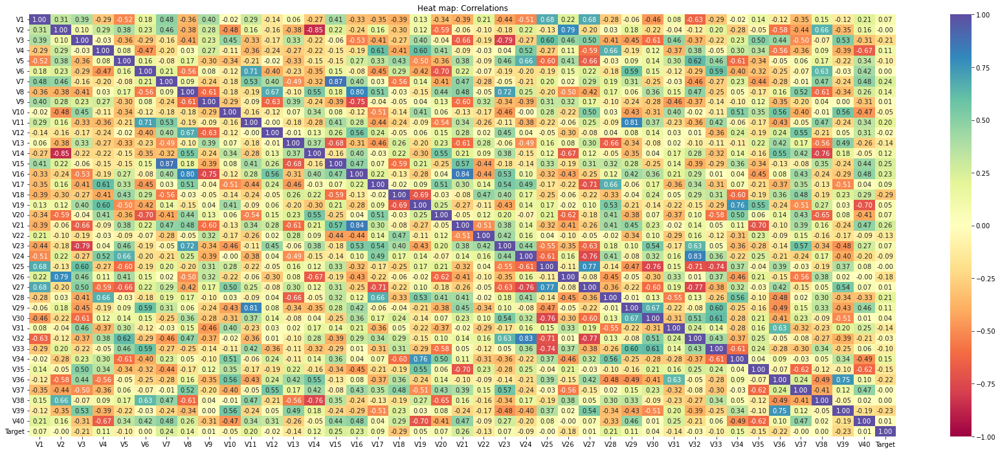

In [ ]:
plt.figure(figsize=(30, 12))
sns.heatmap(df.corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral")
plt.title("Heat map: Correlations");
plt.show()

There is a correlation greater than 80% between variables:

    1. V15 and V7
    2. V16 and V8
    3. V29 and V11
    4. V21 and V16
    5. V32 and V24

In [ ]:
sns.pairplot(df, hue="Target", corner=True)
plt.show()

* In general features V7,V12, V15,16,V18,V21,V22,V35 have very defined patterns between classes as they interact with the other variable.

In [ ]:
half_1 = df[['V1','V2','V3','V4','V5','V6','V7','V8','V9','V10','Target']]
half_2 = df[['V11','V12','V13','V14','V15','V16','V17','V18','V19','V20','Target']]
half_3 = df[['V21','V22','V23','V24','V25','V26','V27','V28','V29','V30','Target']]
half_4 = df[['V31','V32','V33','V34','V35','V36','V37','V38','V39','V40','Target']]

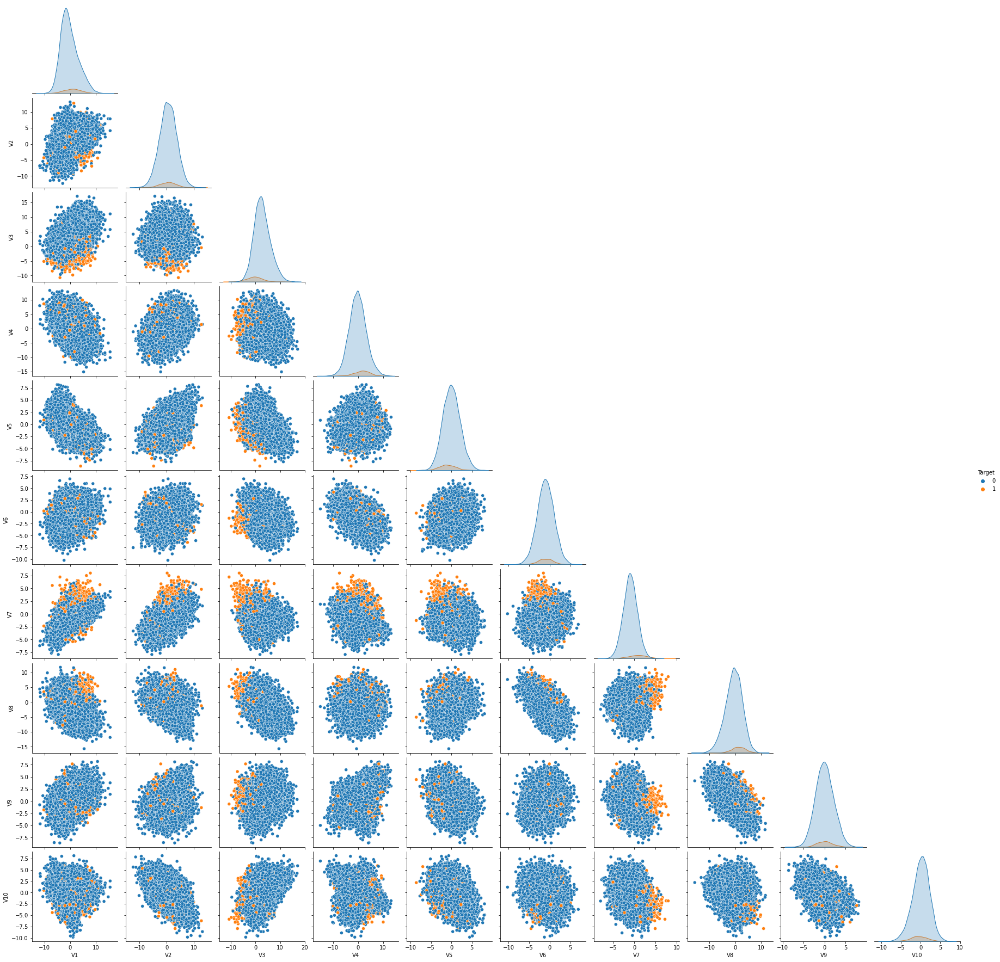

In [ ]:
sns.pairplot(half_1, hue="Target", corner=True, diag_kind='kde')
plt.show()

* V1, V2, V4, V5, V6, V8, V9, V10 KDEs overlap.
* V7 class 1 does not overlap on the right end - Class 1 might be the one causing the outliers for this feature. This variable has potential to define the model.

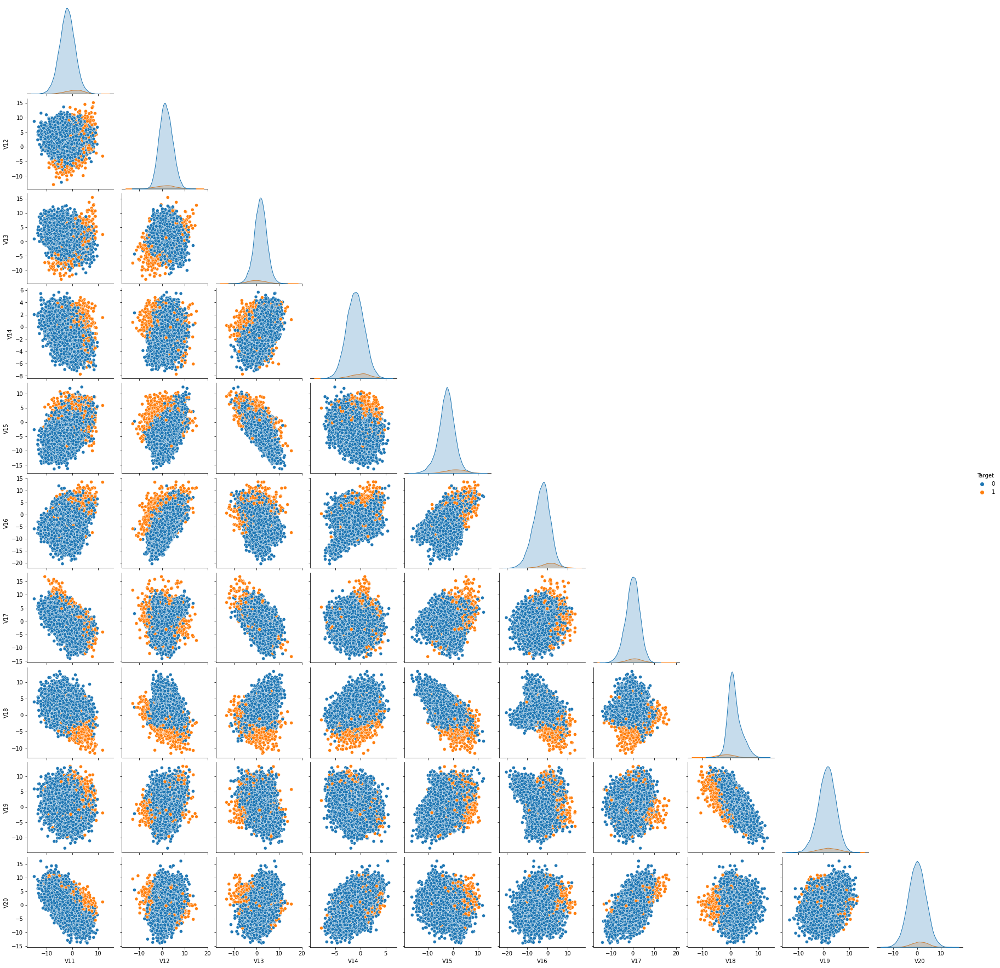

In [ ]:
sns.pairplot(half_2, hue="Target", corner=True, diag_kind='kde')
plt.show()

* V14, V15, V16, V19, V20 KDEs overlap.
* V18 class 1 does not overlap on the left end – Class 1 might be the one causing the outliers for this feature. This variable has potential to define the model.
* V11, V17 classes 1 do not overlap on the right end - Class 1 might be the one causing the outliers for these features. These variables have potential to define the model.
* V12, V13 do not overlap on both ends - Class 1 might be the one causing the outliers for these features. These variables have potential to define the model.


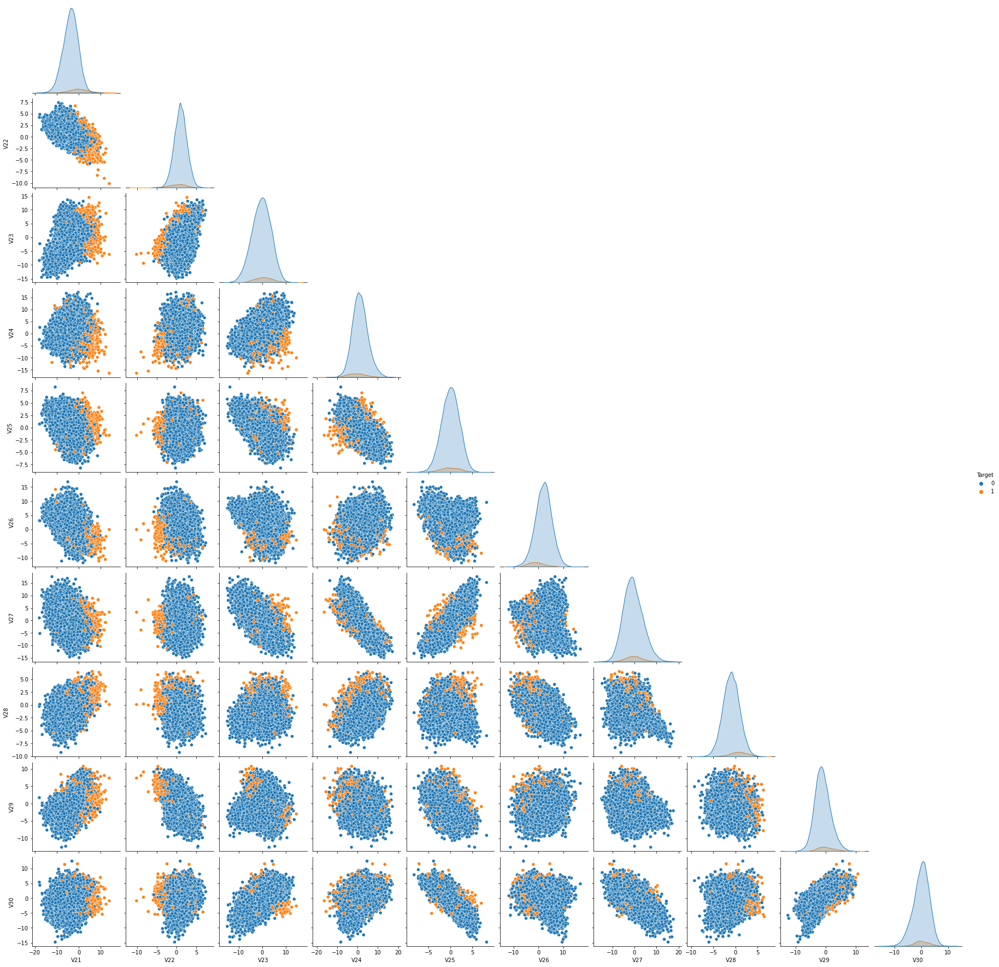

In [ ]:
sns.pairplot(half_3, hue="Target", corner=True, diag_kind='kde')
plt.show()

* V23, V25, V26, V27, V30 KDEs overlap.
* V22, V24, classes 1 do not overlap on the left end – Class 1 might be the one causing the outliers for these features. These variables have potential to define the model.
* V21 class 1 does not overlap on the right end - Class 1 might be the one causing the outliers for this feature. This variable has potential to define the model.


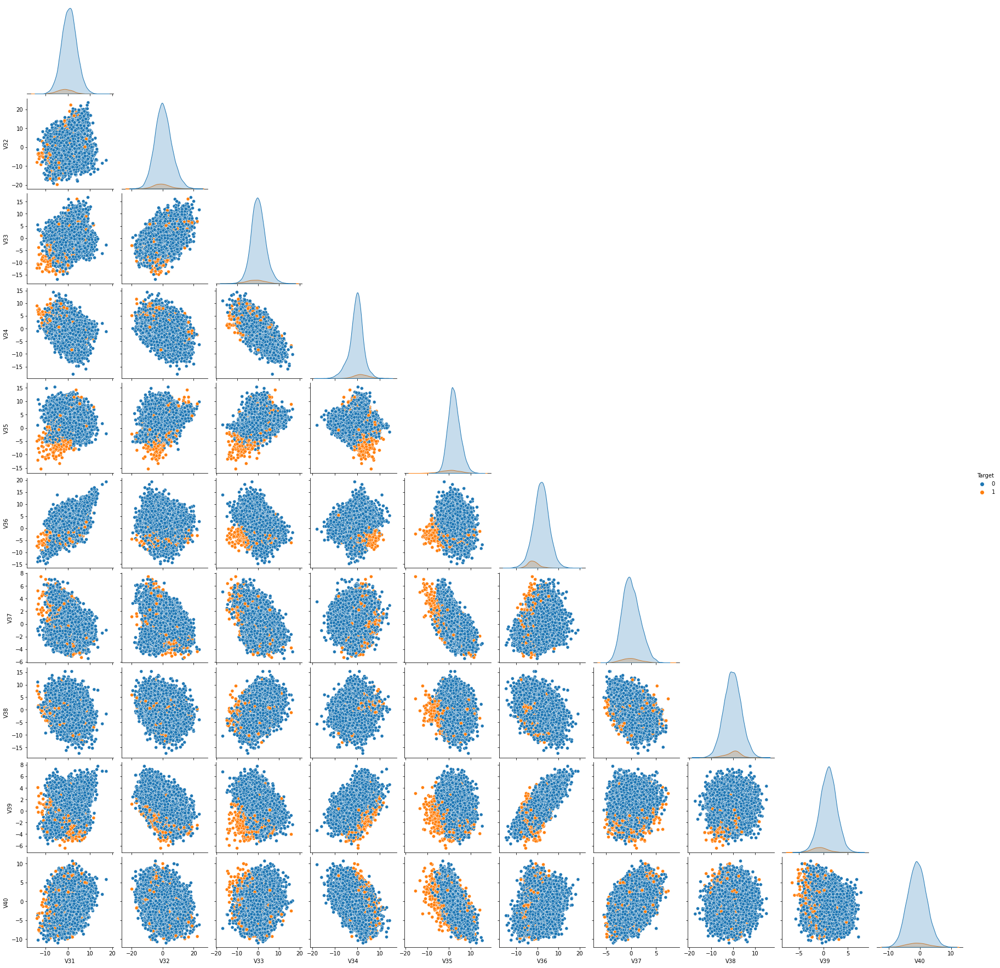

In [ ]:
sns.pairplot(half_4, hue="Target", corner=True, diag_kind='kde')
plt.show()

* V31, V32, V33, V34, V36, V37, V38, V40 KDEs overlap.
* V39 class 1 does not overlap on the left end – Class 1 might be the one causing the outliers for this feature. This variable has potential to define the model.
* V35 class 1 does not overlap on the right end - Class 1 might be the one causing the outliers for this feature. This variable has potential to define the model.


### Plotting histograms and boxplots for all the variables

In [ ]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to the show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, palette="winter"
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

### Plotting all the features at one go

##### Univariate analysis

/var/folders/2z/8l4hxyv918n_w3h80my3t7580000gn/T/ipykernel_30509/3188613800.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f2, (ax_box2, ax_hist2) = plt.subplots(


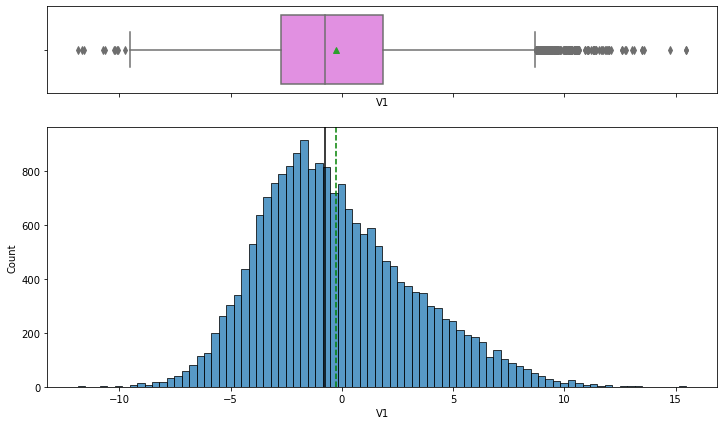

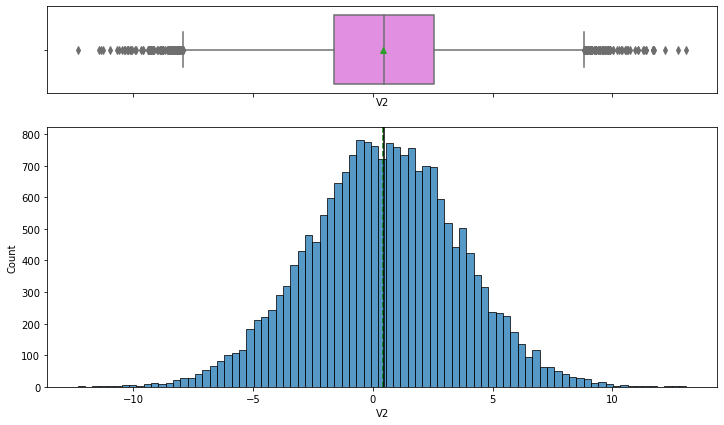

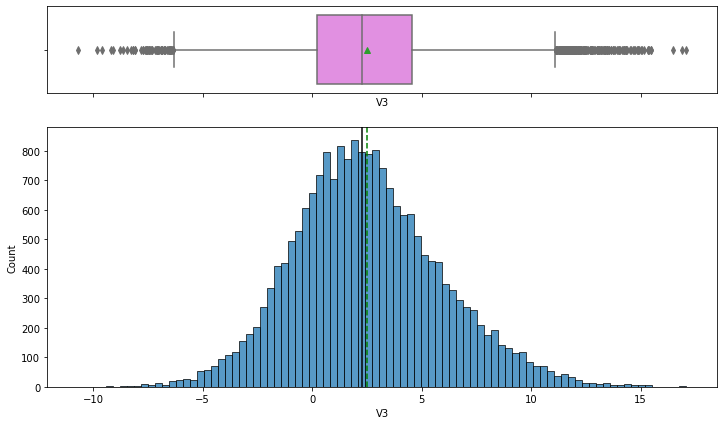

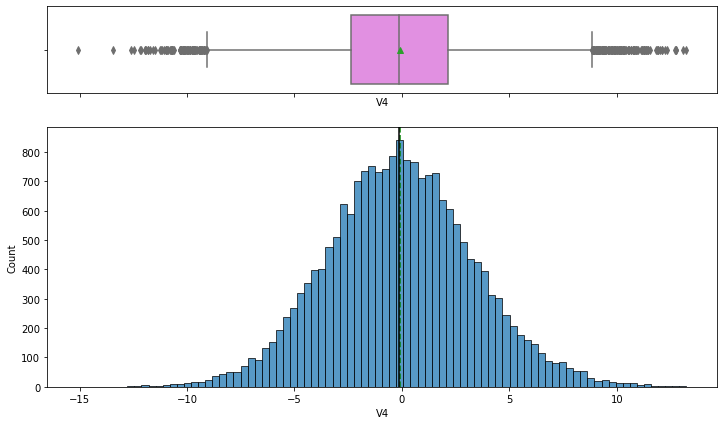

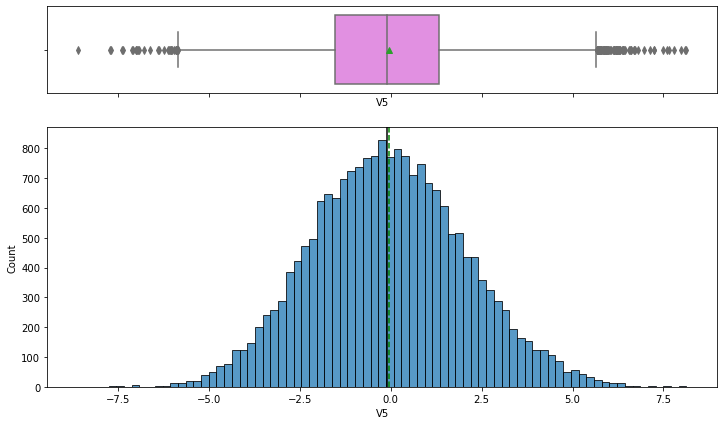

...

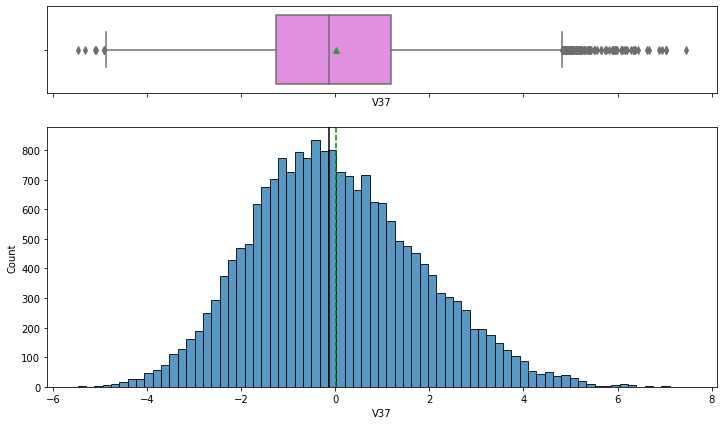

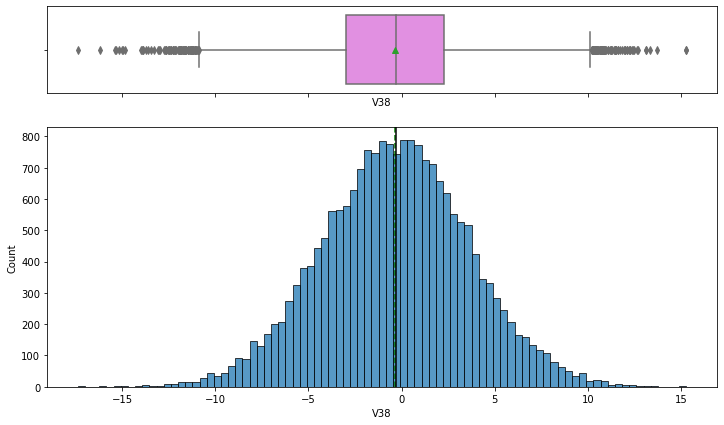

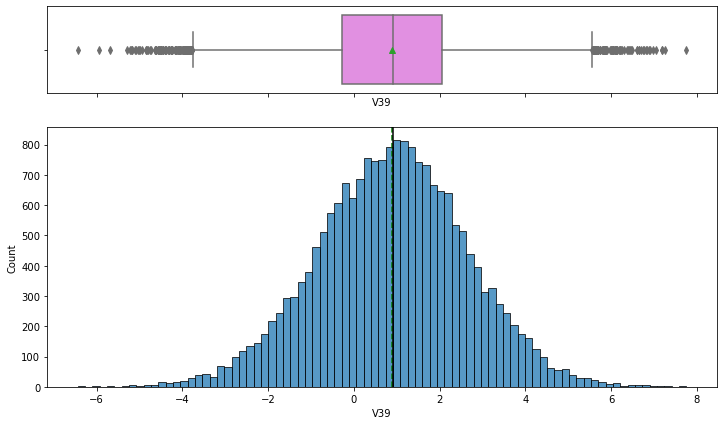

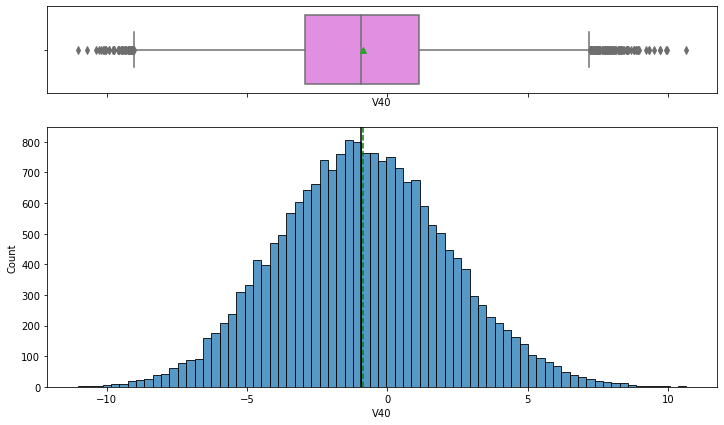

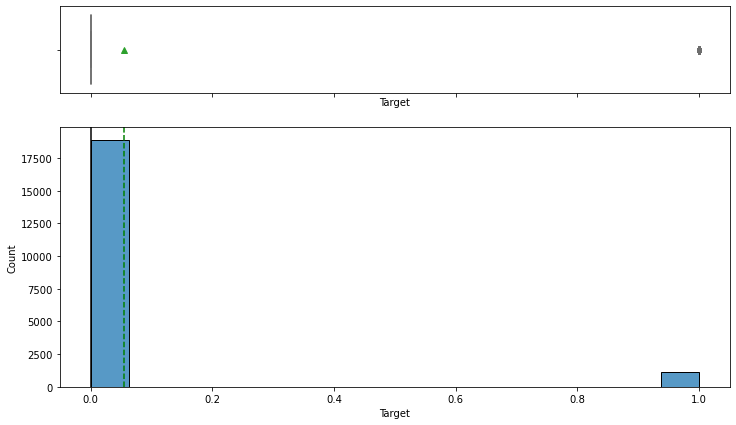

In [ ]:
for feature in df.columns:
    histogram_boxplot(df, feature, figsize=(12, 7), kde=False, bins=None) 

* V1, V3, V7,V9, V18, V27, V29, V32, V37, V40 is skewed to the right.
* V2,V4,V5, V6,V11,V14,V15, V20, V22,V28, V31 V28,V39 have a normal distribution (mean and median are the same).
* V8, V10,V16,V17,V19,V21,V30 are slightly skewed to the left
* Target is a Boolean variable where 1 class is the minority class. 

* Skewness for all variables is soft.
* All variables have outliers. These values will be taken as real values.

## Data Pre-processing

In [ ]:
# To split the data
from sklearn.model_selection import train_test_split

# To impute missing values
from sklearn.impute import SimpleImputer

In [ ]:
x = df.drop(["Target"], axis=1)
y = df["Target"]

In [ ]:
# Splitting the data in train and validation sets
x_train, x_val, y_train, y_val = train_test_split(
    x, y, test_size=0.3, random_state=5, stratify=y
)

In [ ]:
print(x_train.shape, x_val.shape)

(14000, 40) (6000, 40)


## Missing value imputation




In [ ]:
# Let's impute the missing values with the median
imp_mode = SimpleImputer(missing_values=np.nan, strategy="median")
cols_to_impute = ["V1", "V2"]

# After splitting the data, we can impute values and avoid data leakage.
# fit and transform the imputer on train data
x_train[cols_to_impute] = imp_mode.fit_transform(x_train[cols_to_impute])

# Transform on validation and test data
x_val[cols_to_impute] = imp_mode.transform(x_val[cols_to_impute])

In [ ]:
# Double checking that naan values were treated.
x_train.isna().sum()

V1     0
V2     0
V3     0
V4     0
V5     0
V6     0
V7     0
V8     0
V9     0
V10    0
V11    0
V12    0
V13    0
V14    0
V15    0
V16    0
V17    0
V18    0
V19    0
V20    0
V21    0
V22    0
V23    0
V24    0
V25    0
V26    0
V27    0
V28    0
V29    0
V30    0
V31    0
V32    0
V33    0
V34    0
V35    0
V36    0
V37    0
V38    0
V39    0
V40    0
dtype: int64

In [ ]:
x_val.isna().sum()

V1     0
V2     0
V3     0
V4     0
V5     0
V6     0
V7     0
V8     0
V9     0
V10    0
V11    0
V12    0
V13    0
V14    0
V15    0
V16    0
V17    0
V18    0
V19    0
V20    0
V21    0
V22    0
V23    0
V24    0
V25    0
V26    0
V27    0
V28    0
V29    0
V30    0
V31    0
V32    0
V33    0
V34    0
V35    0
V36    0
V37    0
V38    0
V39    0
V40    0
dtype: int64

## Model Building

### Model evaluation criterion

The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model.
- False negatives (FN) are real failures in a generator where there is no detection by model. 
- False positives (FP) are failure detections in a generator where there is no failure.

**Which metric to optimize?**

* We need to choose the metric which will ensure that the maximum number of generator failures are predicted correctly by the model.
* We would want Recall to be maximized as greater the Recall, the higher the chances of minimizing false negatives.
* We want to minimize false negatives because if a model predicts that a machine will have no failure when there will be a failure, it will increase the maintenance cost.

In [ ]:
# defining a function to compute different metrics to check performance of a classification model built using sklearn
def model_performance_classification_sklearn(model, predictors, target):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    """

    # predicting using the independent variables
    pred = model.predict(predictors)

    acc = accuracy_score(target, pred)  # to compute Accuracy
    recall = recall_score(target, pred)  # to compute Recall
    precision = precision_score(target, pred)  # to compute Precision
    f1 = f1_score(target, pred)  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {
            "Accuracy": acc,
            "Recall": recall,
            "Precision": precision,
            "F1": f1
            
        },
        index=[0],
    )

    return df_perf

### Defining scorer to be used for cross-validation and hyperparameter tuning

- We want to reduce false negatives and will try to maximize "Recall".
- To maximize Recall, we can use Recall as a **scorer** in cross-validation and hyperparameter tuning.

In [ ]:
# To get different performance metrics
import sklearn.metrics as metrics
from sklearn.metrics import (
    classification_report,
    confusion_matrix,
    recall_score,
    accuracy_score,
    precision_score,
    f1_score,
)

In [ ]:
# Recall: Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

### Model Building with original data

In [ ]:
# To help with model building
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (
    AdaBoostClassifier,
    GradientBoostingClassifier,
    RandomForestClassifier,
    BaggingClassifier,
)
from xgboost import XGBClassifier

from sklearn.model_selection import StratifiedKFold, cross_val_score

import statsmodels.api as sm

Sample Decision Tree model building with original data 

In [ ]:
%%time

models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Random forest", RandomForestClassifier(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GBM", GradientBoostingClassifier(random_state=1)))
models.append(("Adaboost", AdaBoostClassifier(random_state=1)))
models.append(("Xgboost", XGBClassifier(random_state=1, eval_metric="logloss")))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=x_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(x_train, y_train)
    scores = recall_score(y_val, model.predict(x_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training dataset:

dtree: 0.7155583126550868
Random forest: 0.7193961952026469
Bagging: 0.6833498759305211
GBM: 0.715550041356493
Adaboost: 0.6318775847808106
Xgboost: 0.7915384615384615

Validation Performance:

dtree: 0.7237237237237237
Random forest: 0.7177177177177178
Bagging: 0.6876876876876877
GBM: 0.7027027027027027
Adaboost: 0.6186186186186187
Xgboost: 0.8138138138138138
CPU times: user 6min 27s, sys: 1.97 s, total: 6min 29s
Wall time: 6min 23s


Best performing models:

    1. Random Forest with a -0.23% variation on test and validation recall score.
    2. Bagging with a 0.63% variation on test and validation recall score.
    3. Decision Tree with a 1.14% variation on test and validation recall score.
    
* None of the models were overfitting nor underfitting since the variation between test recall scores and validation set recall scores were lower than 5%. 
* The best models of this block were chosen based on the lowest variation on train and validation recalls.

### Model Building with Oversampled data


In [ ]:
# Installing imblearn to create oversample data sets
!pip install imblearn --user

!pip install imbalanced-learn --user

In [ ]:
pip install -U imbalanced-learn

Note: you may need to restart the kernel to use updated packages.


In [ ]:
conda install -c conda-forge imbalanced-learn

Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 22.9.0
  latest version: 22.11.1

Please update conda by running

    $ conda update -n base -c conda-forge conda



# All requested packages already installed.

Retrieving notices: ...working... done

Note: you may need to restart the kernel to use updated packages.


In [ ]:
# To undersample and oversample the data
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

In [ ]:
# Synthetic Minority Over Sampling Technique
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
x_train_over, y_train_over = sm.fit_resample(x_train, y_train)

In [ ]:
%%time

models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Random forest", RandomForestClassifier(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GBM", GradientBoostingClassifier(random_state=1)))
models.append(("Adaboost", AdaBoostClassifier(random_state=1)))
models.append(("Xgboost", XGBClassifier(random_state=1, eval_metric="logloss")))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on oversample training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=x_train_over, y=y_train_over, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(x_train_over, y_train_over)
    scores = recall_score(y_val, model.predict(x_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on oversample training dataset:

dtree: 0.97111096494113
Random forest: 0.9832110939202503
Bagging: 0.9734550961051737
GBM: 0.9259622099757199
Adaboost: 0.899720507108151
Xgboost: 0.989941916498174

Validation Performance:

dtree: 0.7777777777777778
Random forest: 0.8498498498498499
Bagging: 0.7987987987987988
GBM: 0.8798798798798799
Adaboost: 0.8348348348348348
Xgboost: 0.8738738738738738
CPU times: user 10min 53s, sys: 7.11 s, total: 11min 1s
Wall time: 9min 21s


Best performing model:

    1. GBM with a -4.98% variation on test and validation recall score.
   
    
* The model was not overfitting since the variation between test recall score and validation set recall score was lower than 5%. 
* The best model of this block was chosen based on the lowest variation. 
* Decision Tree will be also considered since its the being the simplest model. 
* Scores improved  compared to the unbalanced set, however, all models except for GBM were overfitting.

### Model Building with Undersampled data

In [ ]:
# Random undersampler for under sampling the data
rus = RandomUnderSampler(random_state=1, sampling_strategy=1)
x_train_un, y_train_un = rus.fit_resample(x_train, y_train)

In [ ]:
%%time

models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Random forest", RandomForestClassifier(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GBM", GradientBoostingClassifier(random_state=1)))
models.append(("Adaboost", AdaBoostClassifier(random_state=1)))
models.append(("Xgboost", XGBClassifier(random_state=1, eval_metric="logloss")))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training undersample dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=x_train_un, y=y_train_un, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(x_train_un, y_train_un)
    scores = recall_score(y_val, model.predict(x_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training undersample dataset:

dtree: 0.8326799007444169
Random forest: 0.8944665012406947
Bagging: 0.8725889164598841
GBM: 0.8893548387096775
Adaboost: 0.8829114971050455
Xgboost: 0.8996112489660877

Validation Performance:

dtree: 0.8408408408408409
Random forest: 0.8918918918918919
Bagging: 0.8498498498498499
GBM: 0.8918918918918919
Adaboost: 0.8588588588588588
Xgboost: 0.8978978978978979
CPU times: user 35.6 s, sys: 1.42 s, total: 37 s
Wall time: 36.5 s


Best performing models:

    1. XGBoost with a 0.19% variation on test and validation recall score.
    2. Random Forest with a 0.29% variation on test and validation recall score.
    3. GBM Tree with a 0.29% variation on test and validation recall score.
    4. Decision Tree with a 0.98% variation on test and validation recall score.
    
* The best models of this block were chosen based on the lowest variation on recall scores.
* In comparison to the oversample data, under sample data returned high recall scores and all models are not underfitting nor overfitting.


## HyperparameterTuning 

### Sample Parameter Grids

**Hyperparameter tuning can take a long time to run, so to avoid that time complexity - you can use the following grids, wherever required.**

- For Gradient Boosting:

param_grid = {
    "n_estimators": np.arange(100,150,25),
    "learning_rate": [0.2, 0.05, 1],
    "subsample":[0.5,0.7], 
    "max_features":[0.5,0.7]
}

- For Adaboost:

param_grid = {
    "n_estimators": [100, 150, 200],
    "learning_rate": [0.2, 0.05],
    "base_estimator": [DecisionTreeClassifier(max_depth=1, random_state=1), DecisionTreeClassifier(max_depth=2, random_state=1), DecisionTreeClassifier(max_depth=3, random_state=1),
    ]
}

- For Bagging Classifier:

param_grid = {
    'max_samples': [0.8,0.9,1], 
    'max_features': [0.7,0.8,0.9],
    'n_estimators' : [30,50,70],
}

- For Random Forest:

param_grid = {
    "n_estimators": [200,250,300],
    "min_samples_leaf": np.arange(1, 4),
    "max_features": [np.arange(0.3, 0.6, 0.1),'sqrt'],
    "max_samples": np.arange(0.4, 0.7, 0.1)
}

- For Decision Trees:

param_grid = {
    'max_depth': np.arange(2,6), 
    'min_samples_leaf': [1, 4, 7],
    'max_leaf_nodes' : [10, 15],
    'min_impurity_decrease': [0.0001,0.001]
}

- For Logistic Regression:

param_grid = {'C': np.arange(0.1,1.1,0.1)}

- For XGBoost:

param_grid={
    'n_estimators': [150, 200, 250],
    'scale_pos_weight': [5,10],
    'learning_rate': [0.1,0.2],
    'gamma': [0,3,5],
    'subsample': [0.8,0.9]
}

### Sample tuning method for Decision tree with original data

In [ ]:
# To tune a model with Random CV
from sklearn.model_selection import RandomizedSearchCV

In [ ]:
# defining model: Decision Tree
dtree = DecisionTreeClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_depth': np.arange(2,6),
              'min_samples_leaf': [1, 4, 7], 
              'max_leaf_nodes' : [10,15],
              'min_impurity_decrease': [0.0001,0.001] }

#Calling RandomizedSearchCV
dtree_tuned = RandomizedSearchCV(estimator=dtree, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
dtree_tuned.fit(x_train,y_train)

dtree_tuned_score = dtree_tuned.best_score_

print("Best parameters are {} with CV score={}:" .format(dtree_tuned.best_params_,dtree_tuned.best_score_))


Best parameters are {'min_samples_leaf': 7, 'min_impurity_decrease': 0.0001, 'max_leaf_nodes': 15, 'max_depth': 5} with CV score=0.5534798534798535:


In [ ]:
dtree_tuned_score_train = dtree_tuned.best_score_
print("Recall score train set:",dtree_tuned_score_train)
dtree_tuned_score_val = recall_score(y_val, dtree_tuned.predict(x_val))
print("Recall score validation set:",dtree_tuned_score_val)

Recall score train set: 0.5534798534798535
Recall score validation set: 0.5225225225225225


In [ ]:
model_performance_classification_sklearn(dtree_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.969167,0.522523,0.87,0.652908


In [ ]:
dtree_tuned_dic = {"Train Recall":[dtree_tuned_score_train],"Validation Recall": [dtree_tuned_score_val]}
dtree_t_s = pd.DataFrame(dtree_tuned_dic)
print("Recall scores comparison:")
dtree_t_s

Recall scores comparison:


,Train Recall,Validation Recall
0,0.55348,0.522523


* This Decision Tree model with unbalanced data has a very low recall score and the variation on train and validation sets for recall is -5.59%, hence the model is overfitting.

In [ ]:
# Defining model: Random Forest
randomforest = RandomForestClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {"n_estimators": [200,250,300], 
              "min_samples_leaf": np.arange(1, 4), 
              "max_features": [np.arange(0.3, 0.6, 0.1),'sqrt'], 
              "max_samples": np.arange(0.4, 0.7, 0.1) }

#Calling RandomizedSearchCV
randomforest_tuned = RandomizedSearchCV(estimator=randomforest, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomforest_tuned.fit(x_train,y_train)

randomforest_tuned_score = randomforest_tuned.best_score_

print("Best parameters are {} with CV score={}:" .format(randomforest_tuned.best_params_,randomforest_tuned.best_score_))


Best parameters are {'n_estimators': 250, 'min_samples_leaf': 1, 'max_samples': 0.6, 'max_features': 'sqrt'} with CV score=0.7077922077922079:


In [ ]:
randomforest_tuned_score_train = randomforest_tuned.best_score_
print("Recall score train set:",randomforest_tuned_score_train)
randomforest_tuned_score_val = recall_score(y_val, randomforest_tuned.predict(x_val))
print("Recall score validation set:",randomforest_tuned_score_val)

Recall score train set: 0.7077922077922079
Recall score validation set: 0.7087087087087087


In [ ]:
model_performance_classification_sklearn(randomforest_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.983333,0.708709,0.987448,0.825175


In [ ]:
rf_tuned_dic = {"Train Recall":[randomforest_tuned_score_train],"Validation Recall": [randomforest_tuned_score_val]}
rf_t_s = pd.DataFrame(rf_tuned_dic)
print("Recall scores comparison:")
rf_t_s

Recall scores comparison:


,Train Recall,Validation Recall
0,0.707792,0.708709


* This Random Forest Tuned model with unbalanced data has a variation of recall score of 0.13%, hence the model is not underfitting.
* Recall score is still low.

In [ ]:
# Defining model Bagging:
bagging = BaggingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_samples': [0.8,0.9,1], 
              'max_features': [0.7,0.8,0.9], 
              'n_estimators' : [30,50,70] }

#Calling RandomizedSearchCV
bagging_tuned = RandomizedSearchCV(estimator=bagging, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
bagging_tuned.fit(x_train,y_train)

bagging_tuned_score = bagging_tuned.best_score_

print("Best parameters are {} with CV score={}:" .format(bagging_tuned.best_params_,bagging_tuned.best_score_))


Best parameters are {'n_estimators': 50, 'max_samples': 0.9, 'max_features': 0.8} with CV score=0.730969030969031:


In [ ]:
bagging_tuned_score_train = bagging_tuned.best_score_
print("Recall score train set:",bagging_tuned_score_train)
bagging_tuned_score_val = recall_score(y_val, bagging_tuned.predict(x_val))
print("Recall score validation set:",bagging_tuned_score_val)

Recall score train set: 0.730969030969031
Recall score validation set: 0.7267267267267268


In [ ]:
model_performance_classification_sklearn(bagging_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.984167,0.726727,0.98374,0.835924


In [ ]:
bagging_tuned_dic = {"Train Recall":[bagging_tuned_score_train],"Validation Recall": [bagging_tuned_score_val]}
bagg_t_s = pd.DataFrame(bagging_tuned_dic)
print("Recall scores comparison:")
bagg_t_s

Recall scores comparison:


,Train Recall,Validation Recall
0,0.730969,0.726727


* This Bagging model with unbalanced data has a variation of recall score of -0,58%, hence the model is not overfitting.
* Recall score is still low.

### Sample tuning method for Decision tree with oversampled data

In [ ]:
# Defining model Decision Tree oversample
dtree_os = DecisionTreeClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_depth': np.arange(2,6),
              'min_samples_leaf': [1, 4, 7], 
              'max_leaf_nodes' : [10,15],
              'min_impurity_decrease': [0.0001,0.001] }

#Calling RandomizedSearchCV
dtree_os_tuned = RandomizedSearchCV(estimator=dtree_os, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
dtree_os_tuned.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(dtree_os_tuned.best_params_,dtree_os_tuned.best_score_))

Best parameters are {'min_samples_leaf': 4, 'min_impurity_decrease': 0.0001, 'max_leaf_nodes': 15, 'max_depth': 4} with CV score=0.8785443846390464:


In [ ]:
dtree_os_tuned_score_train = dtree_os_tuned.best_score_
print("Recall score train set:",dtree_os_tuned_score_train)
dtree_os_tuned_score_val = recall_score(y_val, dtree_os_tuned.predict(x_val))
print("Recall score validation set:",dtree_os_tuned_score_val)

Recall score train set: 0.8785443846390464
Recall score validation set: 0.8378378378378378


In [ ]:
model_performance_classification_sklearn(dtree_os_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.896667,0.837838,0.330178,0.473684


In [ ]:
dtree_os_tuned_dic = {"Train Recall":[dtree_os_tuned_score_train],"Validation Recall": [dtree_os_tuned_score_val]}
dtree_os_t = pd.DataFrame(dtree_os_tuned_dic)
print("Recall scores comparison:")
dtree_os_t

Recall scores comparison:


,Train Recall,Validation Recall
0,0.878544,0.837838


* This Decision Tree with oversample data has a variation of recall score of -4.63%, hence the model is not overfitting.
* Recall score value is good with 0.8785 for train set and 0.837838 for validation set.

In [ ]:
# Defining model Gradient Boosting oversample
gb_os = GradientBoostingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {"n_estimators": np.arange(100,150,25),
              "learning_rate": [0.2, 0.05, 1], 
              "subsample":[0.5,0.7], 
              "max_features":[0.5,0.7]  }

#Calling RandomizedSearchCV
gb_os_tuned = RandomizedSearchCV(estimator=gb_os, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
gb_os_tuned.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(gb_os_tuned.best_params_,gb_os_tuned.best_score_))

Best parameters are {'subsample': 0.7, 'n_estimators': 125, 'max_features': 0.5, 'learning_rate': 1} with CV score=0.9679356160013175:


In [ ]:
gb_os_tuned_score_train = gb_os_tuned.best_score_
print("Recall score train set:",gb_os_tuned_score_train)
gb_os_tuned_score_val = recall_score(y_val, gb_os_tuned.predict(x_val))
print("Recall score validation set:",gb_os_tunned_score_val)

Recall score train set: 0.9679356160013175
Recall score validation set: 0.8318318318318318


In [ ]:
model_performance_classification_sklearn(gb_os_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.9675,0.831832,0.665865,0.739653


In [ ]:
gb_os_tuned_dic = {"Train Recall":[gb_os_tuned_score_train],"Validation Recall": [gb_os_tuned_score_val]}
gb_os_t = pd.DataFrame(gb_os_tuned_dic)
print("Recall scores comparison:")
gb_os_t

Recall scores comparison:


,Train Recall,Validation Recall
0,0.967936,0.831832


* This GB with oversample data has a variation on recall score of -14.06%, hence the model is overfitting.


### Sample tuning method for Decision tree with undersampled data

In [ ]:
# Defining model Decision Tree undersample
dtree_us = DecisionTreeClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_depth': np.arange(2,20),
              'min_samples_leaf': [1, 2, 5, 7], 
              'max_leaf_nodes' : [5, 10,15],
              'min_impurity_decrease': [0.0001,0.001] }

#Calling RandomizedSearchCV
dtree_us_tuned = RandomizedSearchCV(estimator=dtree_us, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
dtree_us_tuned.fit(x_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(dtree_us_tuned.best_params_,dtree_us_tuned.best_score_))

Best parameters are {'min_samples_leaf': 1, 'min_impurity_decrease': 0.001, 'max_leaf_nodes': 15, 'max_depth': 11} with CV score=0.8340326340326341:


In [ ]:
dtree_us_tuned_score_train = dtree_us_tuned.best_score_
print("Recall score train set:",dtree_us_tuned_score_train)
dtree_us_tuned_score_val = recall_score(y_val, dtree_us_tuned.predict(x_val))
print("Recall score validation set:",dtree_us_tuned_score_val)

Recall score train set: 0.8340326340326341
Recall score validation set: 0.8348348348348348


In [ ]:
model_performance_classification_sklearn(dtree_us_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.908833,0.834835,0.361039,0.50408


In [ ]:
dtree_us_tuned_dic = {"Train Recall":[dtree_us_tuned_score_train],"Validation Recall": [dtree_us_tuned_score_val]}
dtree_us_t = pd.DataFrame(dtree_us_tuned_dic)
print("Recall scores comparison:")
dtree_us_t

Recall scores comparison:


,Train Recall,Validation Recall
0,0.834033,0.834835


* This Decision Tree with undersample data has a variation on recall score of 0.10%, hence the model is not underfitting.
* Recall score value is good with 0.834033 for train set and 0.834835 for validation set.

In [ ]:
# Defining model Random Forest undersample
rf_us = RandomForestClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {"n_estimators": [200,250,300], 
              "min_samples_leaf": np.arange(1, 4), 
              "max_features": [np.arange(0.3, 0.6, 0.1),'sqrt'], 
              "max_samples": np.arange(0.4, 0.7, 0.1) }

#Calling RandomizedSearchCV
rf_us_tuned = RandomizedSearchCV(estimator=rf_us, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
rf_us_tuned.fit(x_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(rf_us_tuned.best_params_,rf_us_tuned.best_score_))

Best parameters are {'n_estimators': 300, 'min_samples_leaf': 1, 'max_samples': 0.6, 'max_features': 'sqrt'} with CV score=0.9008991008991009:


In [ ]:
rf_us_tuned_score_train = rf_us_tuned.best_score_
print("Recall score train set:",rf_us_tuned_score_train)
rf_us_tuned_score_val = recall_score(y_val, rf_us_tuned.predict(x_val))
print("Recall score validation set:",rf_us_tuned_score_val)

Recall score train set: 0.9008991008991009
Recall score validation set: 0.8918918918918919


In [ ]:
model_performance_classification_sklearn(rf_us_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.941667,0.891892,0.486088,0.629237


In [ ]:
rf_us_tuned_dic = {"Train Recall":[rf_us_tuned_score_train],"Validation Recall": [rf_us_tuned_score_val]}
rf_us_t = pd.DataFrame(rf_us_tuned_dic)
print("Recall scores comparison:")
rf_us_t

Recall scores comparison:


,Train Recall,Validation Recall
0,0.900899,0.891892


* This Random Forest with undersample data has a variation on recall score of -1.0%, hence the model is not overfitting.
* Recall score value is really good with 0.900899 for train set and 0.891892 for validation set.

In [ ]:
# Defining model Gradient Boosting undersample
gb_us = GradientBoostingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {"n_estimators": np.arange(100,150,25), 
              "learning_rate": [0.2, 0.05, 1], 
              "subsample":[0.5,0.7], 
              "max_features":[0.5,0.7]  }

#Calling RandomizedSearchCV
gb_us_tuned = RandomizedSearchCV(estimator=gb_us, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
gb_us_tuned.fit(x_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(gb_us_tuned.best_params_,gb_us_tuned.best_score_))

Best parameters are {'subsample': 0.5, 'n_estimators': 125, 'max_features': 0.7, 'learning_rate': 0.2} with CV score=0.8996669996669997:


In [ ]:
gb_us_tuned_score_train = gb_us_tuned.best_score_
print("Recall score train set:",gb_us_tuned_score_train)
gb_us_tuned_score_val = recall_score(y_val, gb_us_tuned.predict(x_val))
print("Recall score validation set:",gb_us_tuned_score_val)

Recall score train set: 0.8996669996669997
Recall score validation set: 0.8858858858858859


In [ ]:
model_performance_classification_sklearn(gb_us_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.914,0.885886,0.38163,0.533454


In [ ]:
gb_us_tuned_dic = {"Train Recall":[gb_us_tuned_score_train],"Validation Recall": [gb_us_tuned_score_val]}
gb_us_t = pd.DataFrame(gb_us_tuned_dic)
print("Recall scores comparison:")
gb_us_t

Recall scores comparison:


,Train Recall,Validation Recall
0,0.899667,0.885886


* This GB with undersample data has a variation on recall score of -1.53%, hence the model is not overfitting.
* Recall score value is really good with 0.899667 for train set and 0.885886 for validation set.

In [ ]:
# Defining model XGB undersample
xgb_us = XGBClassifier(random_state=1, eval_metric="logloss")

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [150, 200, 250], 
              'scale_pos_weight': [5,10], 
              'learning_rate': [0.1,0.2], 
              'gamma': [0,3,5], 
              'subsample': [0.8,0.9]  }

#Calling RandomizedSearchCV
xgb_us_tuned = RandomizedSearchCV(estimator=xgb_us, param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=10, random_state=1)

#Fitting parameters in RandomizedSearchCV
xgb_us_tuned.fit(x_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(xgb_us_tuned.best_params_,xgb_us_tuned.best_score_))

Best parameters are {'subsample': 0.8, 'scale_pos_weight': 10, 'n_estimators': 200, 'learning_rate': 0.1, 'gamma': 5} with CV score=0.927955377955378:


In [ ]:
xgb_us_tuned_score_train = xgb_us_tuned.best_score_
print("Recall score train set:",xgb_us_tuned_score_train)
xgb_us_tuned_score_val = recall_score(y_val, xgb_us_tuned.predict(x_val))
print("Recall score validation set:",xgb_us_tuned_score_val)

Recall score train set: 0.927955377955378
Recall score validation set: 0.9159159159159159


In [ ]:
model_performance_classification_sklearn(xgb_us_tuned, x_val,y_val)

,Accuracy,Recall,Precision,F1
0,0.858333,0.915916,0.27063,0.417808


In [ ]:
xgb_us_tuned_dic = {"Train Recall":[xgb_us_tuned_score_train],"Validation Recall": [xgb_us_tuned_score_val]}
xgb_us_t = pd.DataFrame(xgb_us_tuned_dic)
print("Recall scores comparison:")
xgb_us_t

Recall scores comparison:


,Train Recall,Validation Recall
0,0.927955,0.915916


* This XGB with undersample data has a variation on recall score of -1.30%, hence the model is not overfitting.
* Recall score value is really good with 0.927955 for train set and 0.915916 for validation set.

## Model performance comparison and choosing the final model

In [ ]:
a = dtree_t_s.append(rf_t_s)
b = a.append(bagg_t_s)
c = b.append(dtree_os_t)
d = c.append(gb_os_t)
e = d.append(dtree_us_t)
f = e.append(rf_us_t)
g = f.append(gb_us_t)
h = g.append(xgb_us_t)

h.set_axis(['DT tuned',
'RF tuned',
'Bagging tuned',
'Dt oversample tuned',
'GB oversample tunes',
'DT undersample tuned',
'RF undersample tuned',
'GB undersample tuned',
'XGB undersample tuned'], axis = 'index', inplace = True)

h

,Train Recall,Validation Recall
DT tuned,0.553480,0.522523
RF tuned,0.707792,0.708709
Bagging tuned,0.730969,0.726727
Dt oversample tuned,0.878544,0.837838
GB oversample tunes,0.967936,0.831832
DT undersample tuned,0.834033,0.834835
RF undersample tuned,0.900899,0.891892
GB undersample tuned,0.899667,0.885886
XGB undersample tuned,0.927955,0.915916


In [ ]:
l = {"% difference":['-5.59%',
'0.13%',
'-0.58%',
'-4.63',
'-14.06%',
'0.10%',
'-1.00%',
'-1.53%',
'-1.30%']}

l = pd.DataFrame(l)
l.set_axis(['DT tuned',
'RF tuned',
'Bagging tuned',
'Dt oversample tuned',
'GB oversample tunes',
'DT undersample tuned',
'RF undersample tuned',
'GB undersample tuned',
'XGB undersample tuned'], axis = 'index', inplace = True)
print("Recall scores percentual change performance between validation and train data:")
l

Recall scores percentual change performance between validation and train data:


,% difference
DT tuned,-5.59%
RF tuned,0.13%
Bagging tuned,-0.58%
Dt oversample tuned,-4.63
GB oversample tunes,-14.06%
DT undersample tuned,0.10%
RF undersample tuned,-1.00%
GB undersample tuned,-1.53%
XGB undersample tuned,-1.30%


* Decision Tree Under sample data is the model with the best performance since it is not underfitting (variation between recall for train and validation set is not above 5%).
* It does not have a recall as high as models XGB under sample data, Random Forest under sample data or GB under sample data, but the chosen model has the lowest variation and is considered above the others for being the simplest model. Additionally, it is preferred above the other models for having a positive variation bellow 5% between train and validation recalls preventing choosing models that fit noise.


#### Final model

In [ ]:
# Final model:
final_model = DecisionTreeClassifier(random_state=1,
                                    min_samples_leaf = 1, 
                                    min_impurity_decrease = 0.001,
                                    max_leaf_nodes = 15, 
                                    max_depth = 11)
final_model.fit(x_train_un,y_train_un)

DecisionTreeClassifier(max_depth=11, max_leaf_nodes=15,
                       min_impurity_decrease=0.001, random_state=1)

In [ ]:
from sklearn import tree

In [ ]:
# Plotting tree
print(tree.export_text(final_model, feature_names=feature_names, show_weights=True))

|--- V18 <= -1.80
|   |--- V16 <= -5.39
|   |   |--- weights: [23.00, 5.00] class: 0
|   |--- V16 >  -5.39
|   |   |--- V9 <= -3.09
|   |   |   |--- weights: [7.00, 6.00] class: 0
|   |   |--- V9 >  -3.09
|   |   |   |--- weights: [11.00, 397.00] class: 1
|--- V18 >  -1.80
|   |--- V39 <= -0.66
|   |   |--- V26 <= 0.70
|   |   |   |--- V15 <= -1.59
|   |   |   |   |--- V12 <= -2.70
|   |   |   |   |   |--- weights: [0.00, 19.00] class: 1
|   |   |   |   |--- V12 >  -2.70
|   |   |   |   |   |--- V37 <= -1.11
|   |   |   |   |   |   |--- weights: [0.00, 5.00] class: 1
|   |   |   |   |   |--- V37 >  -1.11
|   |   |   |   |   |   |--- weights: [27.00, 4.00] class: 0
|   |   |   |--- V15 >  -1.59
|   |   |   |   |--- weights: [9.00, 166.00] class: 1
|   |   |--- V26 >  0.70
|   |   |   |--- V10 <= -1.00
|   |   |   |   |--- weights: [54.00, 7.00] class: 0
|   |   |   |--- V10 >  -1.00
|   |   |   |   |--- weights: [14.00, 20.00] class: 1
|   |--- V39 >  -0.66
|   |   |--- V3 <= -0.47
|   

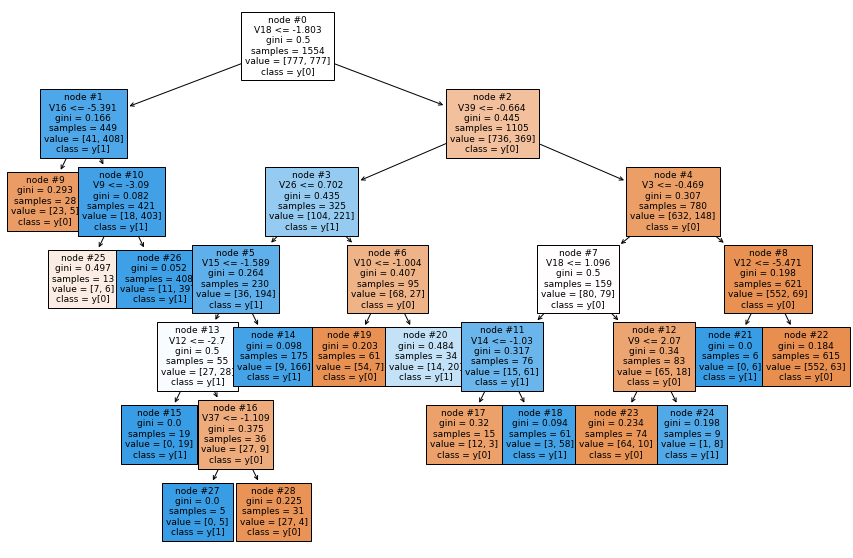

In [ ]:
# Plotting the final model: decision tree under sample data
plt.figure(figsize=(15,10))

tree.plot_tree(final_model,feature_names=feature_names,filled=True,fontsize=9,node_ids=True,class_names=True)
plt.show()

In [ ]:
# Getting the values for the features importances
print (pd.DataFrame(final_model.feature_importances_, columns = ["Imp"], index = x_train_un.columns).sort_values(by = 'Imp', ascending = False))

          Imp
V18  0.436716
V39  0.202221
V26  0.077121
V3   0.069081
V16  0.058381
V12  0.043211
V15  0.029643
V9   0.028808
V14  0.024891
V10  0.017950
V37  0.011978
V27  0.000000
V28  0.000000
V29  0.000000
V30  0.000000
V31  0.000000
V1   0.000000
V32  0.000000
V25  0.000000
V34  0.000000
V35  0.000000
V36  0.000000
V38  0.000000
V33  0.000000
V21  0.000000
V24  0.000000
V23  0.000000
V22  0.000000
V2   0.000000
V20  0.000000
V19  0.000000
V17  0.000000
V13  0.000000
V11  0.000000
V8   0.000000
V7   0.000000
V6   0.000000
V5   0.000000
V4   0.000000
V40  0.000000


* Of the 40 features, only 11 were important to explain the model. 
* These features were the ones considered important for the model: V18, V39, V26, V3, V16, V12, V15, V9, V14, V10,	V37


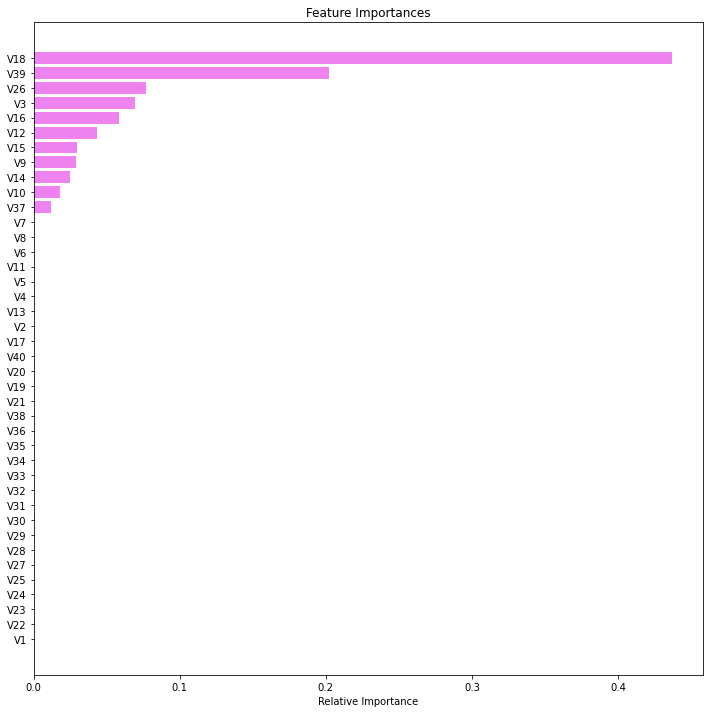

In [ ]:
# Plotting the feature importances 
importances = final_model.feature_importances_
indices = np.argsort(importances)
feature_names = list(x.columns)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

V7,V12, V15,16,V18,V21,V22,V35 

* V8 is the most important feature with 0.436716.
* The least important feature is V37.

## Pipelines to build the final model


In [ ]:
# To be used for creating pipelines and personalizing them
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

In [ ]:
# Getting the data set columns
columns = df.columns
columns

Index(['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31',
       'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40',
       'Target'],
      dtype='object')

In [ ]:
# creating a list of numerical variables
numerical_features = [
       'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31',
       'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40'
   
]

# creating a transformer for numerical variables, which will apply simple imputer on the numerical variables
numeric_transformer = Pipeline(steps=[("imputer", SimpleImputer(missing_values=np.nan, strategy='median'))])

# Column transformer
preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numerical_features)
    ],
        remainder="passthrough",

)


In [ ]:
# Creating new pipeline with best parameters
model = Pipeline(
    steps=[
        ("pre", preprocessor),
        (
            "dtree",
            DecisionTreeClassifier(
            random_state=1,
            min_samples_leaf = 1, 
            min_impurity_decrease = 0.001,
            max_leaf_nodes = 15,
            max_depth = 11,   
           
        ),
        ),
    ]
)
# Fit the model on under sample training data
model.fit(x_train_un,y_train_un)


Pipeline(steps=[('pre',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['V1', 'V2', 'V3', 'V4', 'V5',
                                                   'V6', 'V7', 'V8', 'V9',
                                                   'V10', 'V11', 'V12', 'V13',
                                                   'V14', 'V15', 'V16', 'V17',
                                                   'V18', 'V19', 'V20', 'V21',
                                                   'V22', 'V23', 'V24', 'V25',
                                                   'V26', 'V27', 'V28', 'V29',
                                                   'V30', ...])])),
                ('dtree',
                 DecisionTreeClassifier(max_depth=11, max_leaf_nodes=15,
                                        min_impurity_decrease=0.001,
                                        random_state=1))])

* Pipeline to run the model in a fast and easy way in production. 

### Test set final performance

In [ ]:
# Importing the test set to put the model into production. 
test_set = pd.read_csv("Test.csv")

In [ ]:
x_test = test_set.drop(["Target"], axis=1)
y_test = test_set["Target"]


In [ ]:
# Running the model on the train data set
model = model_performance_classification_sklearn(model, x_test, y_test)
model

,Accuracy,Recall,Precision,F1
0,0.9068,0.815603,0.357143,0.49676


In [ ]:
# Summary of the recall scores for the decision tree undersample data model for train, validation and test data performance
dtree_us_tuned_dic = {"Train Recall":[dtree_us_tuned_score_train],"Validation Recall": [dtree_us_tuned_score_val], "Test Recall":[0.815603]}
dtree_us_t = pd.DataFrame(dtree_us_tuned_dic)
print("Recall scores comparison:")
dtree_us_t

Recall scores comparison:


,Train Recall,Validation Recall,Test Recall
0,0.834033,0.834835,0.815603


In [ ]:
l = {"% difference":['0.10%',
'-2.30%',
'-2.21%',
]}

l = pd.DataFrame(l)
l.set_axis(['Train vs Validation',
'Validation vs Test',
'Train vs Test'],
axis = 'index', inplace = True)
print("Recall scores percentual changes in performance between data sets:")
l

Recall scores percentual changes in performance between data sets:


,% difference
Train vs Validation,0.10%
Validation vs Test,-2.30%
Train vs Test,-2.21%


* This model is nor overfitting nor underfitting for  train vs validation and validation/train vs test since their percentual change in performance is bellow 5%.

# Business Insights and Conclusions

* The best model found with the RandomizedSearchCV method is a Decision Tree with under sample data. The best parameters for the model are: random_state=1, min_samples_leaf = 1, min_impurity_decrease = 0.001, max_leaf_nodes = 15 and max_depth = 1.
* This model has good performance in train and validation sets with a difference in Recall score of 0.10%. It was not underfitting.
* This model also performed well in the test data with a difference of -2.30% between performances in validation set Recall and test set Recall. It was not overfitting. 
* This model is nor overfitting nor underfitting for train vs validation and validation/train vs test since their percentual change in performance is bellow 5%.
* The model has a very low Precision performance which impacts also in a low F1 score performance (in validation and test sets).
 - Precision performance for validation and test sets: 0.361039 and 0.357143 (-1.08% change).
 - F1 score performance for validation and test sets: 0.50408 and 0.49676 (-1.45% change).
* Accuracy for this model, for both validation set, and test set is high with 0.908833 and 0.9068 respectively, but this score is not taken with high importance since the data is highly unbalanced.

IMPORTANT FEATURES:
* The most important feature is V18 followed by V39 and V18.
* From 40 features, 11 ended up being important to the model: V18, V39, V26, V3, V16, V12, V15, V9, V14, V10, V37.
* In the pairplot feature V18 class 1 and class 0 are well defined in certain areas for all variables.
* In the pairplot feature V18 when interacting with itself in the KDE distribution, part of class 1 bell does not overlap on the left end of the class 0 distribution.


MODEL INTERPRETATION:

* If V18 is lower or equal to -1.80 and V16 is lower or equal to -5.39 then there is NO FAILURE (class 0).
* If V18 is lower or equal to -1.80 and V16 is greater than or equal to -5.39 and V9 is greater than -3.09 then there is FAILURE (class 1).
* If V18 is greater than -1.80 and V39 is lower than or equal to -0.66 and V26 is greater than 0.70:

 1) and V10 is lower or equal to -1.00 then there is NO FAILURE (class 0)
 
 2) but if V10 is greater to -1.00 then there is FAILURE (class 1).



***